# Análise do Dataset CORD-19 Dataset com 18GB de textos sobre artigos ciêntificos sobre a pandemia de covid-19
### Guilherme de Souza 

Link para o dataset -> https://github.com/allenai/cord19

### Instalando bibliotecas


In [2]:
!pip install pandas
!pip install json
!pip install numpy
!pip install matplotlib
!pip install nltk
!pip install tqdm
!pip install networkx

!pip install spacy
!pip install -U pip setuptools wheel
!python -m spacy download en_core_web_sm

ERROR: Could not find a version that satisfies the requirement json (from versions: none)
ERROR: No matching distribution found for json


     --------------------------------------- 12.8/12.8 MB 13.9 MB/s eta 0:00:00
[+] Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


### Importandos bibliotecas:

In [49]:
import spacy 
from spacy.matcher import Matcher 
from spacy.tokens import Span 
from spacy import displacy

import pandas as pd
import json
import math
import numpy as np
import matplotlib.pyplot as plt
import nltk
from tqdm import tqdm
import networkx as nx


### Importando Metadados do dataset cord-19:
#### Rode se estiver rodando esse código no google colab

In [80]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)


from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'pydrive'

#### Começaremos Utilizando o metadata.csv que tem informações chave sobre cada artigo como título e abstract além de informações adicionais como data de publicação, autores e reveista onde foi publicado o artigo

In [ ]:
##Colab Notebook, Rode se estiver no google colab
df = pd.read_csv('/content/drive/MyDrive/Cord-19-Dataset/metadata.csv', encoding='latin')

In [50]:
##Jupyter notebook, Rode se estiver rodando o código localmente
df = pd.read_csv("D:/CORD-19-Dataset-Analysis-GuilhermeSouza/2022-06-02/metadata.csv")

C:\Users\Guilherme\AppData\Local\Temp\ipykernel_536\1177680115.py:2: DtypeWarning: Columns (1,4,5,6,13,14,15,16) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("D:/CORD-19-Dataset-Analysis-GuilhermeSouza/2022-06-02/metadata.csv")


In [51]:
df.head(5)

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,PMC,Surfactant protein-D and pulmonary host defense,10.1186/rr19,PMC59549,11667972,no-cc,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/06ced00a5fc04215949aa...,document_parses/pmc_json/PMC59549.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,PMC,Role of endothelin-1 in lung disease,10.1186/rr44,PMC59574,11686871,no-cc,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/348055649b6b8cf2b9a37...,document_parses/pmc_json/PMC59574.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,PMC,Gene expression in epithelial cells in respons...,10.1186/rr61,PMC59580,11686888,no-cc,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/5f48792a5fa08bed9f560...,document_parses/pmc_json/PMC59580.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


In [52]:
df.columns

Index(['cord_uid', 'sha', 'source_x', 'title', 'doi', 'pmcid', 'pubmed_id',
       'license', 'abstract', 'publish_time', 'authors', 'journal', 'mag_id',
       'who_covidence_id', 'arxiv_id', 'pdf_json_files', 'pmc_json_files',
       'url', 's2_id'],
      dtype='object')

In [53]:
abstracts = df["abstract"]
abstracts.head(5)

0    OBJECTIVE: This retrospective chart review des...
1    Inflammatory diseases of the respiratory tract...
2    Surfactant protein-D (SP-D) participates in th...
3    Endothelin-1 (ET-1) is a 21 amino acid peptide...
4    Respiratory syncytial virus (RSV) and pneumoni...
Name: abstract, dtype: object

#### Dataset se demonstra muito grande, a fim de agilizar processamento pegaremos apenas 1% dele randomicamente.

In [64]:
sample_df = df.sample(frac=0.01)

#### Podemos ver que ele foi prontamente fracionado com partes aleatórias do dataset original, agora temos 10 mil instâncias, 1% das 1 milhão do original

In [65]:
sample_df.head(4)
sample_df.shape

(10567, 19)

In [66]:
sample_df["publish_time"].dtypes

dtype('O')

In [67]:
sample_df["publish_time"] = pd.to_datetime(sample_df["publish_time"])
sample_df["publish_time"].head(10)

712516    2020-07-21
343306    2021-01-01
93172     2020-12-01
892090    2021-11-27
1032107   2022-01-14
415800    2021-01-01
485519    2020-01-01
835532    2019-10-17
336104    2021-01-01
133950    2011-01-01
Name: publish_time, dtype: datetime64[ns]

#### Média da data dos Artigos publicados é do ano de 2020 no mês de fevereiro

In [68]:
sample_df["publish_time"].mean()

Timestamp('2020-02-12 20:34:35.872534272')

#### Temos datas nulas...


In [69]:
sample_df["publish_time"].isnull().values.any()
sample_df["publish_time"].isnull().sum()

23

In [70]:
sample_df.dropna(subset=["publish_time", "title", 'abstract'], inplace=True)

In [71]:
sample_df["publish_time"].isnull().values.any()
sample_df["publish_time"].isnull().sum()

0

In [72]:
publish_dates_year = pd.DatetimeIndex(sample_df["publish_time"]).year
publish_dates_year = np.array(publish_dates_year)
for year in publish_dates_year:
  year = int(year) 
publish_dates_year

array([2021, 2022, 2020, ..., 2021, 2020, 2022], dtype=int64)

In [63]:
unique_publish_dates_year = np.unique(publish_dates_year)
print(unique_publish_dates_year)
len(unique_publish_dates_year)

[1952 1970 1979 1980 1981 1982 1983 1984 1987 1988 1989 1990 1991 1992
 1993 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007
 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020 2021
 2022]


43

In [73]:
count_article_dates_year = []
for date in unique_publish_dates_year:
  count_article_dates_year.append((publish_dates_year == date).sum())

print(count_article_dates_year)
len(count_article_dates_year)

[0, 0, 0, 0, 0, 1, 1, 1, 2, 0, 6, 3, 1, 2, 1, 4, 1, 4, 4, 4, 4, 5, 9, 10, 21, 16, 28, 20, 32, 40, 38, 36, 33, 59, 62, 65, 54, 72, 84, 93, 2546, 3639, 1102]


43

#### Mostrando quando os artigos no dataset sample foram publicados em maioria:

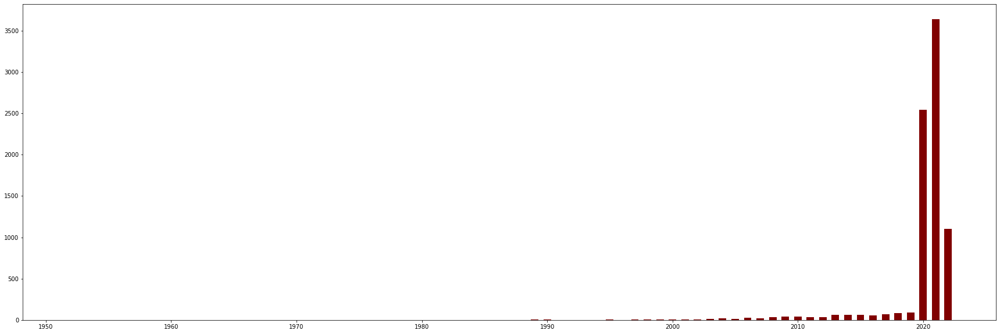

In [74]:
fig = plt.figure(figsize = (30, 10))
plt.bar(unique_publish_dates_year, count_article_dates_year, color ='maroon',
        width = 0.6)
plt.savefig('dates.jpg')

In [75]:
print(sample_df["title"].isnull().values.any(), sample_df["title"].isnull().sum())
print(sample_df["abstract"].isnull().values.any(), sample_df["abstract"].isnull().sum())
sample_df.shape


False 0
False 0


(8109, 19)

In [76]:
print(sample_df["title"].head(10), sample_df["title"].dtype)
print("\n\n\n", sample_df["abstract"].head(10), sample_df["title"].dtype)

892090     Unhealthy Lifestyle, Genetics and Risk of Card...
1032107    Sample attrition analysis in a prospective coh...
485519     Coronavirus COVID-19 Global Cases by the Cente...
835532     IFN-Lambda 3 Mediates Antiviral Protection Aga...
336104     From Spanish flu to syndemic COVID-19: long-st...
133950     Single Incision Laparoscopic Cholecystectomy b...
315967     Randomized geometric tools for anomaly detecti...
649835     Eosinopenia <100/µL as a marker of active COVI...
672238     Analogy of Kaba Suram with COVID-19 Symptoms -...
96962      Multisystem Inflammatory Syndrome in Children ...
Name: title, dtype: object object



 892090     To examine associations of unhealthy lifestyle...
1032107    BACKGROUND: A major challenge of prospective c...
485519     Visit the Johns Hopkins Coronavirus Resource C...
835532     Type III interferon-lambda (IFN-λ) plays a cri...
336104     A second deadlier wave of COVID-19 and the cau...
133950     Purpose. We present our experience i

In [22]:
sample_df["title"] = sample_df["title"].astype('string')
sample_df["abstract"] = sample_df["abstract"].astype('string')

print(sample_df["title"])
print(sample_df["abstract"])

158157     Clinical features associated with COVID-19 out...
749153     Metrics to relate COVID-19 wastewater data to ...
1001261    Three cases of discontinuous refractive index ...
905405     Post-COVID lung fibrosis: The tsunami that wil...
500338     Use of ureteric stent related mobile phone app...
                                 ...                        
796751     Neutrophil extracellular traps enhance macroph...
756174     Statistical Analysis of the People Fully Vacci...
69469      SP8.1.3 Primary care practitioners have a high...
777255     Enclosure with augmented airflow to decrease r...
401290     A comprehensive evaluation of early potential ...
Name: title, Length: 8217, dtype: string
158157     The primary cause of morbidity and mortality i...
749153     Wastewater surveillance has emerged as a usefu...
1001261    We investigate three cases of metamaterials pr...
905405     The SARS-CoV-2 pandemic has already infected i...
500338     Introduction During the COVID-19 

In [77]:
sample_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8109 entries, 892090 to 230115
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   cord_uid          8109 non-null   object        
 1   sha               3293 non-null   object        
 2   source_x          8109 non-null   object        
 3   title             8109 non-null   object        
 4   doi               5328 non-null   object        
 5   pmcid             3143 non-null   object        
 6   pubmed_id         4060 non-null   object        
 7   license           8109 non-null   object        
 8   abstract          8109 non-null   object        
 9   publish_time      8109 non-null   datetime64[ns]
 10  authors           8057 non-null   object        
 11  journal           7355 non-null   object        
 12  mag_id            0 non-null      float64       
 13  who_covidence_id  3490 non-null   object        
 14  arxiv_id         

#### Achando as 100 Palavras mais frequentes nos títulos dos artigos 

In [78]:
import re
import string
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from collections import Counter


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Guilherme\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Guilherme\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


#### Olhando para as stop words do nltk

In [79]:
stopwords.words("english")

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

#### Definindo um função para limpar nossos textos 

In [80]:
## Cleaning para tirar pontuações e URL's além de quebra de linha
def cleaning(text):
    """
    Convert to lowercase.
    Remove URL links, special characters
    """
    text = text.lower()
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('[\=\%\<\>\*\?\+\,\.\!\:\;\-\_\(\)\[\]\'\"]', '', text)
    text = re.sub('\n', '', text)
    text = re.sub('[’“”…]', '', text)
     ## Removing stop words
    tokens = word_tokenize(text)
    text = [t for t in tokens if not t in stopwords.words("english")]
    text = " ".join(text)

    return text
## Cleaning2 é a função cleaning só que sem a retirada de [,.?!:;] e de stopwords 
## pois normalmente as pontuações indicam fim de frase e as stopwords relações do dataset
def cleaning2(text):
    """
    Convert to lowercase.
    Remove URL links, special characters
    """
    text = text.lower()
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('[\=\%\<\>\*\+\-\_\(\)\[\]\'\"]', '', text)
    text = re.sub('\n', '', text)
    text = re.sub('[’“”…]', '', text)

    return text

In [81]:
sample_df_copy = sample_df.copy()

In [82]:
df_title_clean = sample_df_copy["title"].apply(cleaning)
word_count = Counter(" ".join(df_title_clean).split()).most_common(100)
word_count

[('covid19', 3144),
 ('pandemic', 1022),
 ('patients', 752),
 ('sarscov2', 714),
 ('study', 691),
 ('health', 507),
 ('review', 427),
 ('disease', 403),
 ('coronavirus', 392),
 ('infection', 369),
 ('impact', 345),
 ('analysis', 334),
 ('care', 327),
 ('among', 287),
 ('clinical', 276),
 ('using', 260),
 ('case', 249),
 ('respiratory', 229),
 ('virus', 215),
 ('de', 214),
 ('risk', 213),
 ('acute', 211),
 ('model', 206),
 ('learning', 205),
 ('systematic', 199),
 ('treatment', 191),
 ('severe', 182),
 ('syndrome', 177),
 ('human', 175),
 ('management', 174),
 ('role', 173),
 ('social', 171),
 ('cancer', 169),
 ('new', 169),
 ('vaccine', 165),
 ('use', 161),
 ('factors', 159),
 ('novel', 158),
 ('system', 155),
 ('associated', 155),
 ('effects', 150),
 ('outcomes', 150),
 ('based', 149),
 ('data', 148),
 ('response', 147),
 ('approach', 146),
 ('potential', 144),
 ('detection', 143),
 ('2019', 140),
 ('patient', 139),
 ('development', 136),
 ('mortality', 135),
 ('education', 133),
 ('c

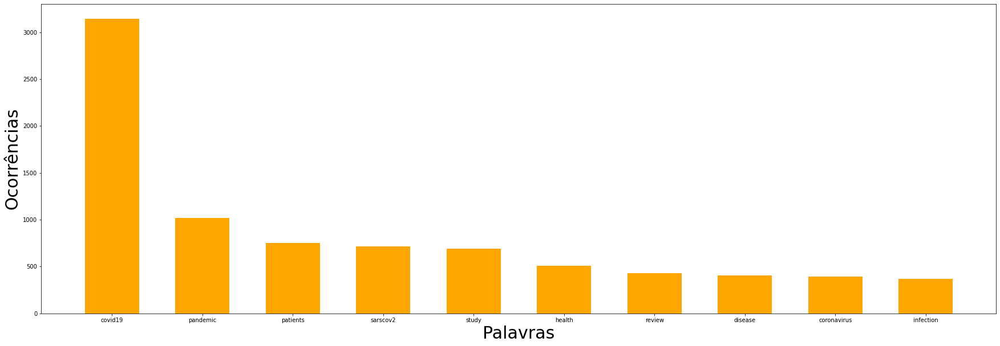

In [83]:
# 10 Palavras mais usadas
x, y = zip(*word_count[:10])

fig = plt.figure(figsize = (30, 10))
plt.xlabel('Palavras', fontsize=30)
plt.ylabel('Ocorrências', fontsize=30)
plt.bar(x, y, color ='orange',
        width = 0.6)
plt.savefig('wordcountTitle10.jpg')

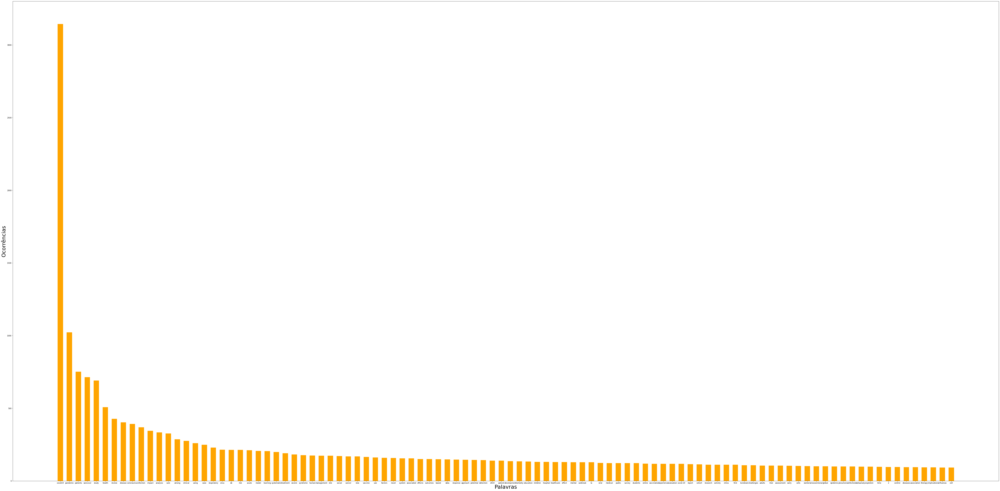

In [84]:
# 100 palavras mais usadas
x, y = zip(*word_count)

fig = plt.figure(figsize = (100, 50))
plt.xlabel('Palavras', fontsize=30)
plt.ylabel('Ocorrências', fontsize=30)
plt.bar(x, y, color ='orange',
        width = 0.6)
plt.savefig('wordcountTitle100.jpg')

#### Achando as 100 Palavras mais frequentes nos abstracts dos artigos

In [85]:
df_abstract_clean = sample_df_copy["abstract"].apply(cleaning)

word_count2 = Counter(" ".join(df_abstract_clean).split()).most_common(100)
word_count2

[('covid19', 12975),
 ('patients', 9489),
 ('study', 5669),
 ('pandemic', 5107),
 ('health', 4929),
 ('results', 4531),
 ('disease', 3919),
 ('sarscov2', 3746),
 ('data', 3730),
 ('using', 3112),
 ('infection', 3046),
 ('clinical', 2954),
 ('may', 2781),
 ('care', 2729),
 ('methods', 2725),
 ('risk', 2665),
 ('used', 2526),
 ('coronavirus', 2526),
 ('2020', 2512),
 ('also', 2502),
 ('p', 2298),
 ('analysis', 2294),
 ('treatment', 2292),
 ('associated', 2210),
 ('use', 2207),
 ('studies', 2203),
 ('among', 2071),
 ('virus', 2058),
 ('cases', 2048),
 ('research', 1994),
 ('social', 1952),
 ('time', 1950),
 ('model', 1915),
 ('severe', 1907),
 ('2', 1906),
 ('respiratory', 1887),
 ('however', 1820),
 ('95', 1775),
 ('compared', 1760),
 ('higher', 1757),
 ('two', 1753),
 ('high', 1750),
 ('new', 1745),
 ('group', 1720),
 ('de', 1710),
 ('significant', 1699),
 ('including', 1651),
 ('1', 1627),
 ('ci', 1607),
 ('different', 1586),
 ('factors', 1582),
 ('years', 1580),
 ('one', 1566),
 ('inc

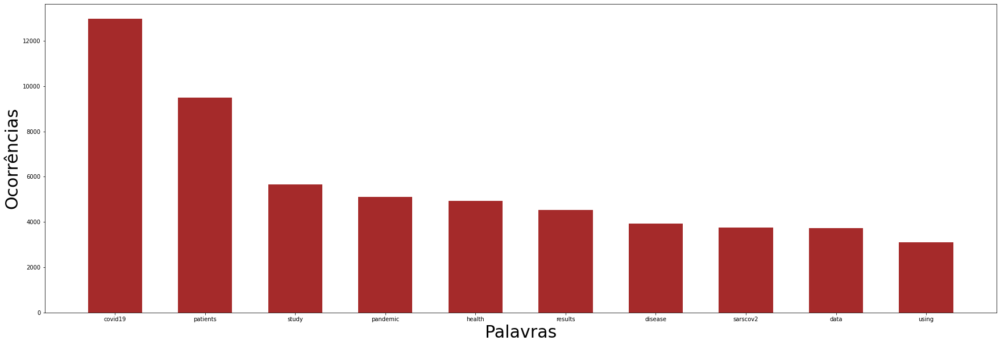

In [86]:
x, y = zip(*word_count2[:10])

fig = plt.figure(figsize = (30, 10))
plt.xlabel('Palavras', fontsize=30)
plt.ylabel('Ocorrências', fontsize=30)
plt.bar(x, y, color ='brown',
        width = 0.6)
plt.savefig('wordcountAbstract10.jpg')

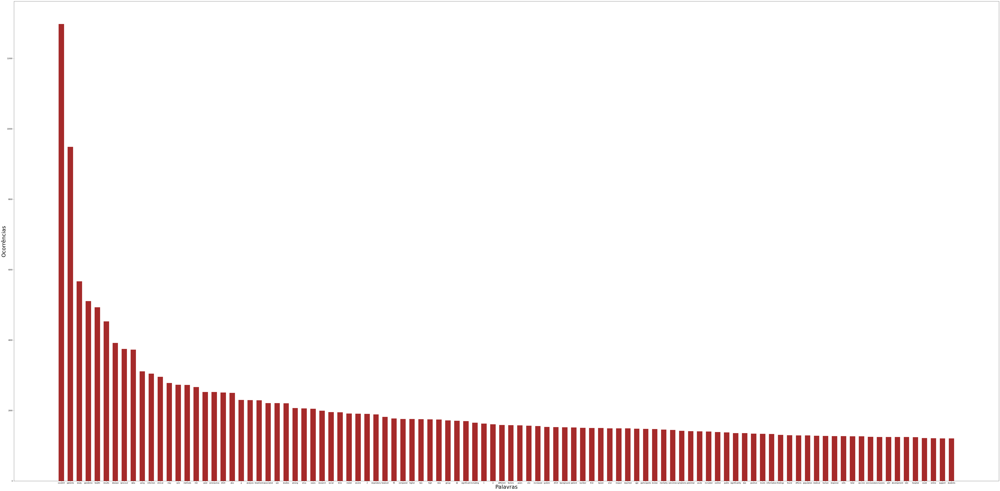

In [87]:
x, y = zip(*word_count2)

fig = plt.figure(figsize = (100, 50))
plt.xlabel('Palavras', fontsize=30)
plt.ylabel('Ocorrências', fontsize=30)
plt.bar(x, y, color ='brown',
        width = 0.6)
plt.savefig('wordcountAbstract100.jpg')

### Começando a utilizar o Spacy com intuito de fazer análises e extrair entidades dos títulos

In [88]:
nlp = spacy.load("en_core_web_sm")

In [89]:
## Função para extração de entidades com base em tokens criados pelo spacy

def get_entities(sentence):
  ## chunk 1
  ent1 = ""
  ent2 = ""

  prv_tok_dep = ""    # dependency tag of previous token in the sentence
  prv_tok_text = ""   # previous token in the sentence

  prefix = ""
  modifier = ""

  #############################################################
  
  for tok in nlp(sentence):
    ## chunk 2
    # if token is a punctuation mark then move on to the next token
    if tok.dep_ != "punct":
      # check: token is a compound word or not
      if tok.dep_ == "compound":
        prefix = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          prefix = prv_tok_text + " "+ tok.text
      
      # check: token is a modifier or not
      if tok.dep_.endswith("mod") == True:
        modifier = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          modifier = prv_tok_text + " "+ tok.text
      
      ## chunk 3
      if tok.dep_.find("subj") == True:
        ent1 = modifier +" "+ prefix + " "+ tok.text
        prefix = ""
        modifier = ""
        prv_tok_dep = ""
        prv_tok_text = ""      

      ## chunk 4
      if tok.dep_.find("obj") == True:
        ent2 = modifier +" "+ prefix +" "+ tok.text
        
      ## chunk 5  
      # update variables
      prv_tok_dep = tok.dep_
      prv_tok_text = tok.text
  #############################################################

  return [ent1.strip(), ent2.strip()]

In [90]:
sample_df["title"] = sample_df["title"].apply(cleaning2)
titles = np.array(sample_df["title"])
titles

array(['unhealthy lifestyle, genetics and risk of cardiovascular disease and mortality in 76,958 individuals from the uk biobank cohort study',
       'sample attrition analysis in a prospective cohort study of medical graduates in china',
       'coronavirus covid19 global cases by the center for systems science and engineering csse',
       ...,
       'a ‘perma response to the pandemic: an online positive education programme to promote wellbeing in university students',
       'the food bank of madrid: a linear model for optimal nutrition',
       'preface of icraic 2021'], dtype=object)

In [91]:
np.random.choice(titles, size=10)

array(['various aspects of noninvasive ventilation in covid19 patients: a narrative review',
       'negative workaholic emotions and emotional exhaustion: might job autonomy have played a strategic role in workers with responsibility during the covid19 crisis lockdown?',
       'teleconsultation in the portuguese national health service during the covid19 pandemic: a survey of physicians views and future implications./ consulta não presencial no serviço nacional de saúde português durante a pandemia de covid19: estudo da opinião dos médicos e implicações para o futuro',
       't cell response in patients with covid19',
       'antibody response following sarscov2 infection and implications for immunity: a living rapid review',
       'flake tools in the european lower paleolithic: a case study from mis 9 britain',
       'survivors concerns during the covid19 pandemic: qualitative insights from the national sexual assault online hotline',
       'risankizumab induced paradoxical pust

#### Pegando as entidades de cada titulo

Observe que as entidades ou ficam sem sujeito ou sem objeto devido a frases de títulos serem mais declarativas, observe também que há uma grande quantidade de sujeitos e objetos compostos devidos a complexidade da escrita realizada em arigos ciêntíficos

In [92]:
entities_title = []
for title in tqdm(titles):
  #Separando Texto em sentenças a partir da pontuação
  sentence_list = []
  sentence_list = nltk.tokenize.sent_tokenize(title)
  for sentence in sentence_list:
      #Pegando entidades de cada sentença
      entities_title.append(get_entities(sentence))


100%|██████████████████████████████████████████████████████████████████████████| 8109/8109 [00:38<00:00, 208.15it/s]


In [93]:
## Quantidade de sentenças 
print(len(entities_title))
## Entidades extraidas
entities_title

8350


[['', '76,958 biobank cohort study'],
 ['', 'medical cohort china'],
 ['', 'global systems science'],
 ['', 'intestinal transcript epithelia'],
 ['', 'brazilian rainforest gateway'],
 ['', 'atraumatic  trocar'],
 ['', 'geometric stock markets'],
 ['', 'active eosinopenia covid19'],
 ['analogy', 'siddha literature review'],
 ['multisystem', 'inflammatory  children'],
 ['', 'posterior covid19 pandemic'],
 ['impact', 'e tendência sistema brasil'],
 ['', 'covid19'],
 ['', 'quantitative north reverse'],
 ['', 'crosssectional survey study'],
 ['', ''],
 ['', 'mental health literacy'],
 ['', '2020 faculty work'],
 ['', 'ultrasonic array probe inspection'],
 ['what', 'elimination'],
 ['', 'public covid19 january'],
 ['municipal water case', 'municipal water availability'],
 ['', 'clinical machine covid19'],
 ['', 'economic  vaccination'],
 ['', 'liver ischemia reperfusion injury'],
 ['', 'resourcepoor treatment settings'],
 ['', 'medical covid19 testing'],
 ['immunocompetent  radiologist', 'im

### Utilizando o Spacy com intuito de fazer análises e extrair entidades dos abstracts

In [94]:
sample_df["abstract"] = sample_df["abstract"].apply(cleaning2)
abstracts = np.array(sample_df["abstract"])
abstracts

array(['to examine associations of unhealthy lifestyle and genetics with risk of allcause mortality, cardiovascular disease cvd mortality, myocardial infarction mi and stroke. we used data on 76,958 adults from the uk biobank prospective cohort study. favourable lifestyle included no overweight/obesity, not smoking, physical activity, not sedentary, healthy diet and adequate sleep. a polygenic risk score prs was derived using 300 cvdrelated single nucleotide polymorphisms. cox proportional hazard ratios hr were used to model effects of lifestyle and prs on risk of cvd and allcause mortality, stroke and mi. new cvd n  364 and allcause n  2408 deaths, and stroke n  748 and mi n  1140 events were observed during a 7.8 year mean followup. an unfavourable lifestyle 0–1 healthy behaviours was associated with higher risk of allcause mortality hr: 2.06; 95 ci: 1.73, 2.45, cvd mortality hr: 2.48; 95 ci: 1.64, 3.76, mi hr: 2.12; 95 ci: 1.65, 2.72 and stroke hr:1.74; 95 ci: 1.25, 2.43 compared to

#### Pegando as entidades de cada abstract

agora as entidades ficaram mais bem compostas devido a estarmos analisando parágrafos maiores que provavelmente tem frases mais bem elaboradas com começo, meio e fim.

In [95]:
sentence_list = nltk.tokenize.sent_tokenize(abstracts[1])
sentence_list

['background: a major challenge of prospective cohort studies is attrition in followup surveys.',
 'this study investigated attrition in a prospective cohort comprised of medical graduates in china.',
 'we described status of attrition, identified participants with higher possibility of attrition, and examined if attrition affect the estimation of the key outcome measures.',
 'methods: the cohort study recruited 3,620 new medical graduates from four medical universities in central and western china between 2015 and 2019. online followup surveys were conducted on an annual basis.',
 'followup status was defined as complete meaning that the participant completed all the followup surveys and incomplete, while incomplete followup was further divided into ‘alwaysout, ‘rejoin and ‘other.',
 'multivariable logistic and linear regressions were used to examine factors predicting attrition and the influence on the outcome measures of career development.',
 'results: 2364 65.3 participants comple

In [96]:
## Exemplo sobre como o tokenizador do nltk para separação de sentenças funciona
sentence_list = nltk.tokenize.sent_tokenize("Does George eat apple? Maria is driving the car. Steven goes to school")



In [97]:
## Exemplo displacy tokens
displacy.render(nlp("Does George eat apple?"), style="dep")
displacy.render(nlp("Maria is driving the car."), style="dep")
displacy.render(nlp("Steven goes to school"), style="dep")
doc = nlp("The disease can cause severe medical complications.")
for token in doc:
    print(token.text,"...",token.dep_)
displacy.render(doc, style="dep")

The ... det
disease ... nsubj
can ... aux
cause ... ROOT
severe ... amod
medical ... amod
complications ... dobj
. ... punct


In [98]:
entities_abstracts = []
for abstract in tqdm(abstracts):
  #Separando Texto em sentenças a partir da pontuação
  sentence_list = nltk.tokenize.sent_tokenize(abstract)
  for sentence in sentence_list:
      #Pegando entidades de cada sentença
      entities_abstracts.append(get_entities(sentence))

100%|███████████████████████████████████████████████████████████████████████████| 8109/8109 [06:06<00:00, 22.14it/s]


In [99]:
print(len(entities_abstracts))
entities_abstracts

65317


[['', 'unhealthy allcause mortality'],
 ['we', 'prospective cohort study'],
 ['favourable  lifestyle', 'overweight  obesity'],
 ['polygenic risk score prs', 'single nucleotide polymorphisms'],
 ['hr', 'cvd'],
 ['1140 new events', '7.8 year mean followup'],
 ['healthy lifestyle behaviours', 'healthy mi behaviours'],
 ['unfavourable lifestyle behaviours', 'genetic cvd risk'],
 ['major  challenge', 'followup cohort surveys'],
 ['study', 'medical  china'],
 ['higher  attrition', 'key outcome measures'],
 ['online followup surveys', 'annual  basis'],
 ['incomplete  followup', 'further  alwaysout'],
 ['logistic  regressions', 'career development'],
 ['65.3  participants', 'followup surveys'],
 ['520  14.4', '2020  survey'],
 ['rural entrance scores or1.64', 'more followup survey'],
 ['factors', 'key career development'],
 ['who', 'early cohort attrition'],
 ['more  information', 'early  participation'],
 ['rural  who', 'more university entrance cohort'],
 ['research team', 'more  cohort'],
 

## Extração de Relações entre entidades para cada frase

#### Função para extrair relações de cada frase:

In [151]:
def get_relation(sent):

  doc = nlp(sent)

  # Matcher class object 
  matcher = Matcher(nlp.vocab)

  #define the pattern 
  pattern = [[{'DEP':'ROOT'}, 
            {'DEP':'prep','OP':"?"},
            {'DEP':'agent','OP':"?"},  
            {'POS':'ADJ','OP':"?"}]] 

  matcher.add("matching_1", pattern) 
  matches = matcher(doc)
  k = len(matches) - 1
  if(len(matches)> 0):
      span = doc[matches[k][1]:matches[k][2]] 
      return(span.text)
  else:
      span = ''
      return span


#### Pegando as relações de cada titulo

In [152]:
relations_title = []
for title in tqdm(titles):
    #Separando Texto em sentenças a partir da pontuação
    sentence_list = nltk.tokenize.sent_tokenize(title)
    for sentence in sentence_list:
      #Pegando as relações de cada sentença
      relations_title.append(get_relation(sentence))
    

100%|██████████████████████████████████████████████████████████████████████████| 8109/8109 [00:32<00:00, 247.57it/s]


In [153]:
print(len(relations_title))
relations_title

8350


['lifestyle',
 'analysis in',
 'cases by',
 'ifnlambda',
 'warnings from',
 'cholecystectomy by',
 'randomized geometric',
 '100/µl as',
 '',
 'misc',
 'ophthalmology with',
 'do',
 'characterizing',
 'detection of',
 'factors',
 'technique',
 'effects of virtual',
 'utopia',
 'validation of',
 'covid19',
 'use of public',
 'study',
 'learning for clinical',
 'influencers of',
 'tlr4 as',
 'factors',
 'pharmacy',
 'pneumonia in',
 'investigated through',
 'survival on',
 'impacts of virusmediated',
 'use',
 'feasibility',
 'design',
 'analysis of infectious',
 'sensitivity',
 'study',
 'turning rural',
 'studies on',
 'therapy',
 'timemaps',
 'dynamics relevant',
 'twitter',
 'focused on',
 'eplerenone for',
 'antibodies among',
 'device in',
 'metaanalysis of surgical',
 'covid19',
 'videoconferencing',
 'report on',
 'effect on',
 'impact of',
 'opioid',
 'curcumin as',
 'systems versus',
 'fibrillation',
 '日本におけるオンライン・ハラスメントの現状と対策：twitterでの女性記者のツイート「炎上」を例に',
 'monitoring of',
 'have

In [154]:
pd.Series(relations_title).value_counts()[:50]

impact of              160
covid19                 88
is                      84
analysis of             70
study                   70
effect of               57
role of                 52
evaluation of           44
effects of              43
review                  40
factors                 34
use of                  27
are                     26
development of          26
associated with         25
exploring               25
assessment of           24
review of               24
comparison of           23
approach                22
study of                21
association of          21
response to             20
characteristics of      19
knowledge               19
assessing               18
detection of            18
results from            17
challenges              16
association between     16
disease                 16
report                  16
impacts of              16
study on                15
analysis                15
influence of            15
                        14
i

#### Pegando as relações para cada abstract

In [155]:
relations_abstract = []
for abstract in tqdm(abstracts):
    #Separando Texto em sentenças a partir da pontuação
    sentence_list = nltk.tokenize.sent_tokenize(abstract)
    for sentence in sentence_list:
      #Pegando as relações de cada sentença
      relations_abstract.append(get_relation(sentence))

100%|███████████████████████████████████████████████████████████████████████████| 8109/8109 [06:04<00:00, 22.26it/s]


In [156]:
print(len(relations_abstract))
relations_abstract

65317


['examine',
 'used',
 'included',
 'derived',
 'used',
 'observed during',
 'associated with higher',
 'predicted higher',
 'is',
 'investigated',
 'described',
 'conducted on',
 'defined as complete',
 'used',
 'results',
 'were',
 'were',
 'have significant',
 'conclusions',
 'provided',
 'were',
 'invest more',
 'contains supplementary',
 'visit',
 'plays',
 'shown',
 'remains elusive',
 'compared',
 'showed',
 'modified',
 'indicated',
 'verified',
 'inhibited',
 'showed',
 'provide important',
 'compared with',
 'are',
 'amplified by',
 'contributed to',
 'modelled',
 'succeeded',
 'predicted',
 'validated',
 'purpose',
 'present',
 'methods',
 'involves',
 'introduced',
 'were',
 'conclusion',
 'claim',
 'propose',
 'results in',
 'introduce',
 'is',
 'implemented',
 'provide accurate',
 'use',
 'objectives',
 'performed from 20th',
 'had myeloid',
 'performed',
 'performed for',
 'were',
 'had',
 'was',
 'was',
 'are useful',
 'aimed at',
 'associated',
 'included',
 'assessed',

In [157]:
pd.Series(relations_abstract).value_counts()[:50]

is                 3278
was                1843
were               1110
are                 895
used                879
showed              617
found               607
had                 569
results             516
included            507
show                452
suggest             417
reported            398
performed           375
associated with     360
revealed            350
conducted           334
aims                303
identified          299
conclusion          297
developed           287
methods             285
be                  279
provide             262
demonstrated        260
objective           249
have                244
needed              233
provides            230
present             226
analyzed            220
evaluated           217
investigated        216
observed            216
assessed            211
study               209
shown               207
report              201
include             194
has                 194
indicate            184
propose         

## Gerando grafos de conhecimento com a networkx a partir da extração de entidades e relações

### Função para busca em grafos a partir de alguma relação

In [158]:
def get_graph_from_relation(relation, kg_df):
    Graph=nx.from_pandas_edgelist(kg_df[kg_df['relation']==relation], "source_node", "target_node", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

    plt.figure(figsize=(20,20))
    plt.title('Relação ' +  '" '+ relation + ' "', fontdict=None, loc='center')
    pos = nx.spring_layout(Graph, k = 0.5)
    nx.draw(Graph, with_labels=True, node_color='pink', node_size=1400, edge_cmap=plt.cm.Blues, pos = pos)
    plt.show()

### Extraindo triplas dos títulos 

In [159]:
source_node_titles = [i[0] for i in entities_title]
target_node_titles = [i[1] for i in entities_title]
relations_titles = [relation for relation in relations_title]

In [160]:
kg_title_df = pd.DataFrame(data={'source_node': source_node_titles, 'target_node': target_node_titles, 'relation': relations_titles})
print(kg_title_df.shape)
kg_title_df.head(20)

(8350, 3)


,source_node,target_node,relation
0,,"76,958 biobank cohort study",lifestyle
1,,medical cohort china,analysis in
2,,global systems science,cases by
3,,intestinal transcript epithelia,ifnlambda
4,,brazilian rainforest gateway,warnings from
5,,atraumatic trocar,cholecystectomy by
6,,geometric stock markets,randomized geometric
7,,active eosinopenia covid19,100/µl as
8,analogy,siddha literature review,
9,multisystem,inflammatory children,misc


#### Removendo triplas sem algum dos campos

In [169]:
kg_title_df.drop(kg_title_df.index[kg_title_df['source_node'] == ''], inplace=True)
kg_title_df.drop(kg_title_df.index[kg_title_df['target_node'] == ''], inplace=True)
kg_title_df.drop(kg_title_df.index[kg_title_df['relation'] == ''], inplace=True)
print(kg_title_df.shape)
kg_title_df.reset_index(drop=True, inplace=True)
kg_title_df.tail(10)

(1668, 3)


,source_node,target_node,relation
1658,covid19,real flu vaccination,is
1659,numbers,themselves,let
1660,magnetic resonance images,nonlinear interaction,mri
1661,left,global pandemic,reflects on
1662,nursing time,faculty leadership training,is
1663,clec4mpositive cd81negative huh7 cells,jfh1 hcvcc infection,are
1664,lessons,driving motility simulation,learned
1665,chinese i,emergency covid19,response to
1666,similarity,covid19 rubella pandemic,genomes
1667,sarscov2 lambda variant,higher infectivity,exhibits higher


### Gerando o grafo de conhecimento para os títulos

In [162]:
## Criando Grafo de entidades
Graph_titles=nx.from_pandas_edgelist(kg_title_df, "source_node", "target_node", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

In [163]:
# Mapeando relações

dict_titles = {}
for i in range(len(kg_title_df)):
    dict_titles.update({(kg_title_df['source_node'][i], kg_title_df['target_node'][i]) : kg_title_df['relation'][i]})
dict_titles

{('multisystem', 'inflammatory  children'): 'misc',
 ('impact', 'e tendência sistema brasil'): 'do',
 ('what', 'elimination'): 'covid19',
 ('municipal water case', 'municipal water availability'): 'study',
 ('immunocompetent  radiologist', 'immunocompetent  what'): 'pneumonia in',
 ('serum metabolic disturbances',
  'serum metabolomics approach'): 'investigated through',
 ('critical metadata analysis', 'world covid19'): 'twitter',
 ('anatomical survey study', 'cranial  cavity'): 'focused on',
 ('seroprevalence', '2019 covid19 patient exposure'): 'antibodies among',
 ('coinfections', 'different vaccination programs'): 'effect on',
 ('nasal', 'opioid case series'): 'opioid',
 ('how  they', 'refractory reflux what'): 'have',
 ('race', 'remdesivir'): 'impact',
 ('highminority nursing homes', 'covid19  deaths'): 'affected by covid19',
 ('molecular structure analyses', 'therapeutically  sarscov2'): 'suggest',
 ('european proclimate leadership', 'economic  brazil'): 'challenged by',
 ('pendek

In [191]:
# Plotando grafo e adicionando relações ao mesmo
plt.figure(figsize=(100,100))

pos = nx.spring_layout(Graph_titles)
nx.draw(
    Graph_titles, pos, edge_color='black', width=1, linewidths=1,
    node_size=500, node_color='pink', alpha=0.9,
    labels={node: node for node in Graph_titles.nodes()}
)
nx.draw_networkx_edge_labels(
    Graph_titles, pos,
    edge_labels=dict_titles,
    font_color='red'
)
plt.savefig('fullTitleGraph.pdf', dpi='figure', format='pdf')
plt.show()


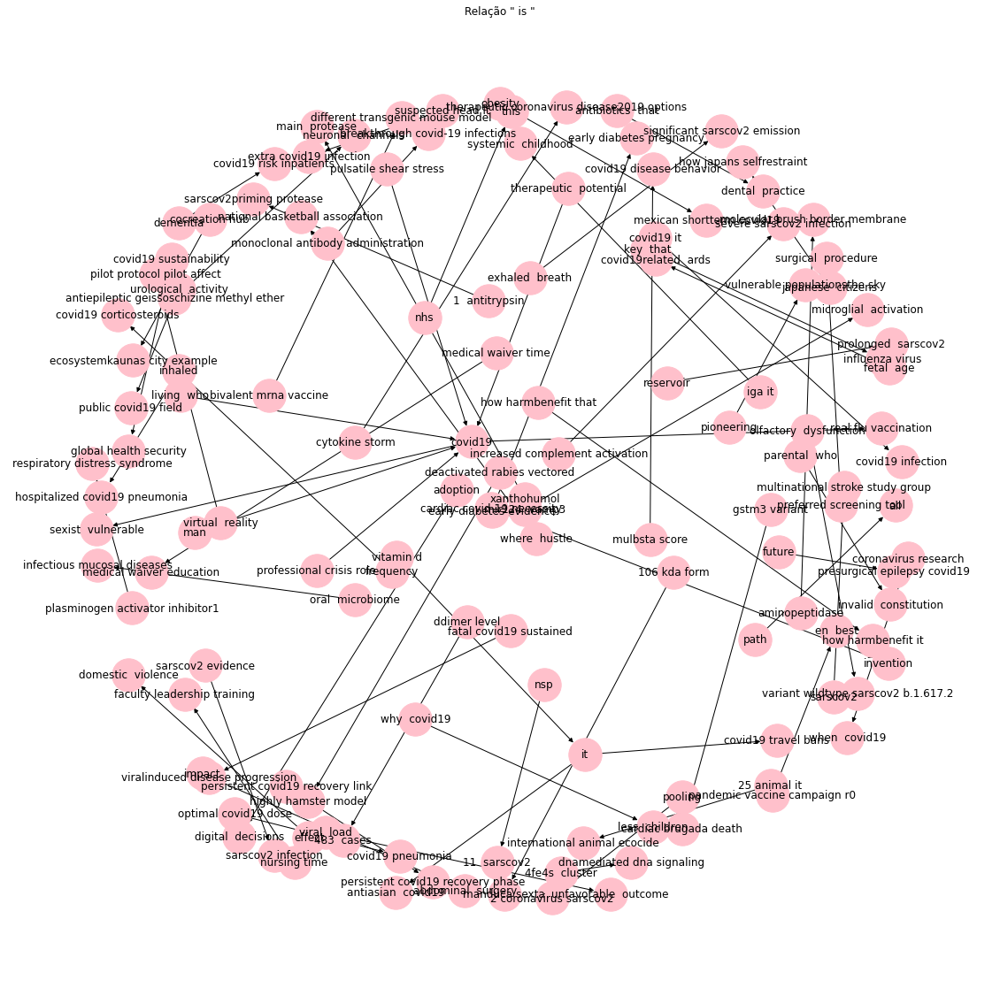

In [174]:
get_graph_from_relation('is', kg_title_df)

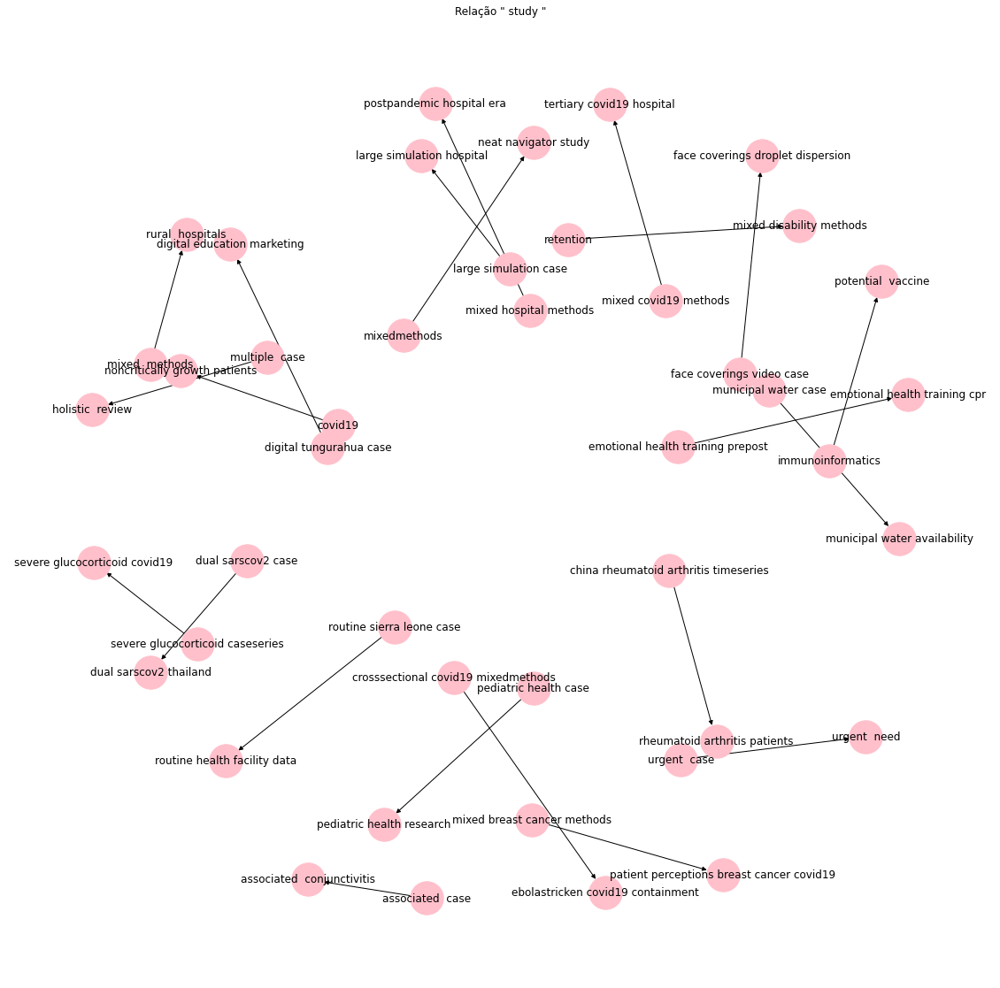

In [185]:
get_graph_from_relation('study', kg_title_df)

### Extraindo tuplas dos abstracts

In [186]:
source_node_abstracts = [i[0] for i in entities_abstracts]
target_node_abstracts = [i[1] for i in entities_abstracts]
relations_abstracts = [relation for relation in relations_abstract]

In [187]:
kg_abstract_df = pd.DataFrame(data={'source_node': source_node_abstracts, 'target_node': target_node_abstracts, 'relation': relations_abstracts})
print(kg_title_df.shape)
kg_abstract_df.tail(10)

(1668, 3)


,source_node,target_node,relation
65307,it,total thirdparty donations,aims
65308,model,spanish case population,applied to
65309,demand,different consumption beneficiaries,is satisfied
65310,results,10 costs,provide
65311,proposed model,economic food madrid,suggests
65312,intelligent robots,scientific life,show great
65313,robots,time,made
65314,2021 chinese icraic2021,2 robotics automation,brought
65315,two xianhua wu,eloquent shanghai maritime speeches,made eloquent
65316,additional programs,24 conference committee pdf,included


#### Removendo triplas sem algum dos campos dos abstracts

In [188]:
kg_abstract_df.drop(kg_abstract_df.index[kg_abstract_df['source_node'] == ''], inplace=True)
kg_abstract_df.drop(kg_abstract_df.index[kg_abstract_df['target_node'] == ''], inplace=True)
kg_abstract_df.drop(kg_abstract_df.index[kg_abstract_df['relation'] == ''], inplace=True)
print(kg_abstract_df.shape)
kg_abstract_df.reset_index(drop=True, inplace=True)
kg_abstract_df.tail(10)

(60300, 3)


,source_node,target_node,relation
60290,it,total thirdparty donations,aims
60291,model,spanish case population,applied to
60292,demand,different consumption beneficiaries,is satisfied
60293,results,10 costs,provide
60294,proposed model,economic food madrid,suggests
60295,intelligent robots,scientific life,show great
60296,robots,time,made
60297,2021 chinese icraic2021,2 robotics automation,brought
60298,two xianhua wu,eloquent shanghai maritime speeches,made eloquent
60299,additional programs,24 conference committee pdf,included


In [190]:
## exportando triplas para csv para rodar no neo4j
kg_abstract_df.to_csv('./abstract_relations.csv', index=False)

### Gerando o grafo de conhecimento para os abstracts

In [ ]:
## Criando Grafo de entidades
Graph_abstract=nx.from_pandas_edgelist(kg_abstract_df, "source_node", "target_node", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

In [ ]:
# Mapeando relações

dict_abstracts = {}
for i in range(len(kg_abstract_df)):
    dict_abstracts.update({(kg_abstract_df['source_node'][i], kg_abstract_df['target_node'][i]) : kg_abstract_df['relation'][i]})
dict_titles

#### Como o grafo é muito grande repare que o código abaixo demora muito tempo para executar
-> O que podemos fazer é cortar a quantidade de relações para que seja possível então visualizar o grafo com a networkx ou podemos colocar nosso grafo em uma base de dados em grafo como o neo4j e pesquisar as relações nela

In [ ]:
# Plotando grafo e adicionando relações ao mesmo
plt.figure(figsize=(100,100))

pos = nx.spring_layout(Graph_abstract)
nx.draw(
    Graph_abstract, pos, edge_color='black', width=1, linewidths=1,
    node_size=500, node_color='blue', alpha=0.9,
    labels={node: node for node in Graph_abstract.nodes()}
)
nx.draw_networkx_edge_labels(
    Graph_abstract, pos,
    edge_labels=dict_titles,
    font_color='red'
)
plt.savefig('fullAbstractGraph', dpi='figure', format='pdf')
plt.show()


In [ ]:
get_graph_from_relation('results', kg_abstract_df)

In [ ]:
get_graph_from_relation('used', kg_abstract_df)

In [ ]:
get_graph_from_relation('reported', kg_abstract_df)

In [ ]:
get_graph_from_relation('included', kg_abstract_df)

## Coisas a fazer:

####  - [X]  Dividir em sentenças cada linha do dataframe (separar por ponto fina ou qualquer marcaçãol)
####  - [X]  Tirar Sample Words na hora de analisar palavras mais presentes
####  - [X]  Fazer grafo de conhecimento para os abstracts
####  - [X]  Fazer grafo de conhecimento para os titulos
####  - []  Criar outras coisas tipo analise sentimental etc...
